## 1. Motivation

The dataset we chose for the project are:
- [New York City Bike Routes](https://data.cityofnewyork.us/Transportation/New-York-City-Bike-Routes/7vsa-caz7?fbclid=IwAR1qhBBuDYaDo53woGk00lEG5IXKk9mrOp2seCaARmlS_Ga_Ifk7046Si7U) - data on bike routes infrastructure in New York from 2017,
- [CitiBike Trips](https://s3.amazonaws.com/tripdata/index.html?fbclid=IwAR15trP4MTHZSkcCqpxBBYtCJLGnAEycwRhWPrYct6QuMSstojYqAamT_D8) - data from the CitiBike system on the trips in New York, updated monthly from 2013.

The datasets were chosen, as we want to look into the problem of low ratio of commuting by bikes in New York and potentially find ways to improve it. We focused on finding datasets with spatial data, so we could visualize them using interactive maps. Moreover, we wanted the datasets to contain data over longer periods of time, to show the fluctuation of biking people across the days, months and years .

The goal of our user's experience is to provide interactive and readable maps with routes and bike trips marked. That way, the user can gain some insights on how the biking infrastructure looks in New York and where people tend to bike the most.

## 2. Basic Stats

The bike infrastructure dataset was from 2017, as it was the only dataset available publicly. That is why we only considered the bike trips from 2014 till 2017. By comparing with an interactive overview of bike routes in New York from 2022 [1.], we believe that the 2017 dataset is still representative, as the infrastructure does not seem to have changed greatly. 2013 has been excluded, since the system was deployed in 2013 and wasn't widely used. The CitiBike data was split across different files (one for each month/year), so it required concatenating. 

Due to the size of the dataset (around 10GB), information on the users of the bikes (e.g. age, gender) was not considered; however, since we are focusing on spatial data, we processed columns related with location and station names, and then summed  the number of bike trips into a new column  "trip count". This column will be used to sort and choose the most popular trips.

The data still needed compression in order visualise it effortlessly, and to do that a new file was created, aggreated by coordinates, year, month, day and hour. This reduced the dataset size to roughly half and enhanced performance greatly.

During initial data exploration, several types of invalid rows were found.  The first problem was that some of the longitude/latitudes contained purely zeros, which would place the bike trips in the Atlantic instead of in New York. These rows, as well as rows containing NAs, were removed. 

It was also found that there were a lot of trips where the starting station and the ending stations were identical. For the hourly dataset, these trips were removed, as it didn't really gave any information on where the roads might be missing.

In [1]:
#!/usr/bin/env python3

import pandas as pd
import folium

data_nyc_citibike = pd.read_csv("../citybike-aggregated-by-hour.csv")
data_nyc_citibike.dropna()

# Removing the incorrect coordinates
data_nyc_citibike = data_nyc_citibike[(data_nyc_citibike["start station latitude"] != 0) & \
                                      (data_nyc_citibike["start station longitude"] != 0) & \
                                      (data_nyc_citibike["end station latitude"] != 0) & \
                                       (data_nyc_citibike["end station longitude"] != 0)]

# Removing loop trips
data_nyc_citibike = data_nyc_citibike[(data_nyc_citibike["start station latitude"] != data_nyc_citibike["end station latitude"]) & \
                                      (data_nyc_citibike["start station longitude"] != data_nyc_citibike["end station longitude"])]


In [2]:
data_nyc_bike_routes = pd.read_csv("../nyc_bike_routes_2017.csv")

# Taking only the coordinates and the route type
data_nyc_bike_routes = data_nyc_bike_routes[["the_geom", "ft_facilit"]]

We ended up with the following size for the trips data:

In [3]:
print(data_nyc_citibike.shape[0])

41340465


The following for the bike routes:

In [4]:
print(data_nyc_bike_routes.shape[0])

19875


The columns we left out for the trips data include:

In [5]:
print(data_nyc_citibike.columns)

Index(['Unnamed: 0', 'start station latitude', 'start station longitude',
       'end station latitude', 'end station longitude', 'start station name',
       'end station name', 'start station id', 'end station id', 'year',
       'month', 'day', 'hour', 'trip count'],
      dtype='object')


And lastly, we chose the following columns for the bike routes:

In [6]:
print(data_nyc_bike_routes.columns)

Index(['the_geom', 'ft_facilit'], dtype='object')



To gain insight into what trips were most popular and what station they occur at, some statistics for the hourly dataset were produced. 

In [7]:
df_by_start_end_destination = data_nyc_citibike.groupby(["start station name", "end station name"]).agg(
                {"trip count" : "sum"}).reset_index()
df_by_start_end_destination = df_by_start_end_destination.sort_values("trip count", ascending=False)

print("Top 5 most popular trips:")
print(df_by_start_end_destination.head(5)[["start station name", "end station name"]])

df_by_station = data_nyc_citibike.groupby("start station name").agg(
                {"trip count" : "sum"}).reset_index()
df_by_station = df_by_station.sort_values("trip count", ascending=False)

print("Top 5 start stations:")
print(df_by_station.head(5)["start station name"])

df_by_station = data_nyc_citibike.groupby("end station name").agg(
                {"trip count" : "sum"}).reset_index()
df_by_station = df_by_station.sort_values("trip count", ascending=False)

print("Top 5 end stations:")
print(df_by_station.head(5)["end station name"])

Top 5 most popular trips:
           start station name       end station name
9740         12 Ave & W 40 St  West St & Chambers St
327546        W 21 St & 6 Ave        9 Ave & W 22 St
369093  West St & Chambers St       12 Ave & W 40 St
275745  Pershing Square North        W 33 St & 7 Ave
328087        W 21 St & 6 Ave       W 22 St & 10 Ave
Top 5 start stations:
662    Pershing Square North
343       E 17 St & Broadway
789          W 21 St & 6 Ave
125          8 Ave & W 31 St
868    West St & Chambers St
Name: start station name, dtype: object
Top 5 end stations:
696    Pershing Square North
353       E 17 St & Broadway
826          W 21 St & 6 Ave
906    West St & Chambers St
194       Broadway & E 22 St
Name: end station name, dtype: object


From this, it can be seen that the most popular trip is from 12 Ave & W 40 St to West St & Chambers St. The most popular starting and ending destination is Pershing Square North.

Additionally, we also looked into the difference in the number of trips for each day of week.


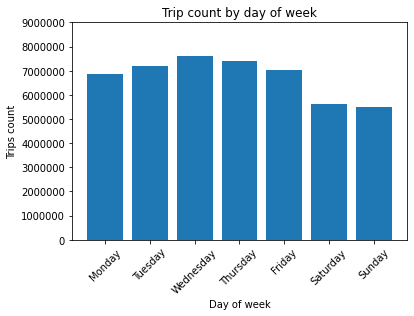

In [8]:
import matplotlib.pyplot as plt

from datetime import datetime

data_nyc_citibike_daily = data_nyc_citibike.groupby(["year", "month", "day"]).agg(
                                {"trip count" : "sum"}).reset_index()
data_nyc_citibike_daily["dayofweek"] = data_nyc_citibike_daily.apply(lambda x: datetime(x["year"], x["month"], x["day"]).weekday(), axis=1)

df_by_dayofweek = data_nyc_citibike_daily.groupby(["dayofweek"]).agg(
                {"trip count" : "sum"}).reset_index()
df_by_dayofweek["dayofweek"] = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

plt.bar(df_by_dayofweek["dayofweek"], df_by_dayofweek["trip count"])

plt.xlabel("Day of week")
plt.ylabel("Trips count")
plt.ticklabel_format(style='plain', axis='y')
plt.title("Trip count by day of week")
plt.ylim([0, 9000000])
plt.xticks(rotation = 45)

plt.savefig('plot_dayofweek_distribution.svg', format='svg', bbox_inches='tight')
plt.show()

It can be seen that the largest number of cyclists is on Wednesdays, while least cyclists takes a trip on Sunday. It looks like most of the people use the bike sharing system during the workdays.

For the bike routes data, we checked what is the distribution of route types.

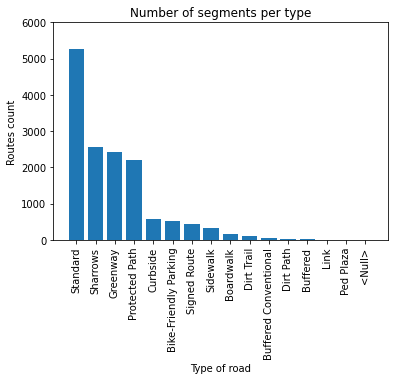

In [9]:
df_by_route_type = data_nyc_bike_routes.groupby("ft_facilit").size().reset_index(name="route count")
df_by_route_type = df_by_route_type.sort_values("route count", ascending=False)

plt.bar(df_by_route_type["ft_facilit"], df_by_route_type["route count"])

plt.xlabel("Type of road")
plt.ylabel("Routes count")
plt.ticklabel_format(style='plain', axis='y')
plt.title("Number of segments per type")
plt.ylim([0, 6000])
plt.xticks(rotation = 90)

plt.savefig('plot_route_distribution.svg', format='svg', bbox_inches='tight')
plt.show()

From this, we can see most standard roads are present, meaning that most of the routes are separated from the car lanes. The next 3 types are: sharrows, greenway and protected path.

In [10]:
import plotly.express as px
import numpy as np

heatmap_df = data_nyc_citibike.loc[:, ['month', 'hour']].copy()

x = ["00", "01", "02", "03", "04", "05", "06", "07", "08", "09", "10", "11", "12", "13", "14", "15", "16", "17", "18", "19", "20", "21", "22", "23" ]
y = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]

heatmap_df['n'] = 1

heatmap_array = []

hours = heatmap_df.hour.unique()
for m in heatmap_df.month.unique(): 
    temp = heatmap_df.loc[heatmap_df.month == m, :]
    heatmap_array.append([])
    for h in hours: 
        n = temp.loc[temp.hour == h, ["n"]].sum()[0]
        heatmap_array[-1].append(n)

fig = px.imshow(heatmap_array, y=y, x=x, color_continuous_scale='blues', labels=dict(x="Hour", y="Month", color="Recorded bike trips"),
    title="Calendar plot of bike trips by month and hour")

fig.update_layout({
    'plot_bgcolor': 'rgba(0, 0, 0, 0)',
    'paper_bgcolor': 'rgba(0, 0, 0, 0)'
})

fig.update_layout(title_x=0.5, title_y=0.83, font_color="black", font_family="sans-serif")
fig.update_layout(width=830, font_size=10)

fig.write_image("plot_calendar.svg")

fig.show()

As we can see, the darkest parts of the graph are for hours 6 and 9 for June-October period. It seems like a lot of people bike in the early hours during the warmer seasons. It might be because of the number of commuters.

It is also noted that surprisingly few cyclists make the trip at 7 and 8, which may be due to several factors such as fewer bikes accessible (since most are used at 6), the car traffic being to heavy to allow for bicyles, or the bike trips being logged wrong in the dataset. 

In [11]:
import numpy as np

df_stations = data_nyc_citibike[["start station latitude", "start station longitude", "end station latitude", "end station longitude",
    "start station name", "end station name"]]

def get_station_names(lat, long):
    start_stations = df_stations[(df_stations["start station latitude"] == lat) & 
    (df_stations["start station longitude"] == long)]["start station name"].drop_duplicates().to_numpy()
    end_stations = df_stations[(df_stations["end station latitude"] == lat) & 
    (df_stations["end station longitude"] == long)]["end station name"].drop_duplicates().to_numpy()
    return np.intersect1d(start_stations, end_stations)


## 3. Data Analysis

Now we are ready to start analysing the data based on our needs. We will be drawing the routes and the trips on the NYC map, to see if we can find places that are not entirely bike-friendly. We will also be looking at any trends and patterns over time. The drawn conclucions have been put under each visualization.

For the first visualization we will plot a general map of all the trips and routes from the entire dataset period.

In [12]:
df_all_time_trips = data_nyc_citibike.groupby(["start station latitude", "start station longitude",
            "end station latitude", "end station longitude"]).agg(
                {"trip count" : "sum"}).reset_index()

print(df_all_time_trips.shape[0])

386148


While the data is narrowed down to only the distinct trips, it is still pretty large and will be hard to render with folium. Due to this, and because plotting all bike trips will make the plots unmanageable, only the 100 most frequently occuring (or popular) trips ar plotted.

In [13]:
df_sorted = df_all_time_trips.sort_values("trip count", ascending=False)
print(df_sorted.shape[0])
df_sorted = df_sorted.head(100)

386148


For the bike routes we had to deserialize "the_geom" column containing the coordinates.

In [14]:
def extract_routes(s):
    geom = s["the_geom"]
    geom = geom.replace(")", "")
    geom = geom.replace("MULTILINESTRING", "")
    geom = geom.replace("(", "")

    split_geom = geom.split(", ")
    split_long_lat = [g.lstrip().split(" ") for g in split_geom]
    split_long_lat_int = [(float(x[1][0:7]), float(x[0][0:7])) for x in split_long_lat]
    
    return split_long_lat_int

routes = [data_nyc_bike_routes.apply(extract_routes, axis=1)]

Next we will create a NYC map and add all the things we extracted in the previous steps.

In [15]:
nyc_map = folium.Map(location=[40.7128, -74.0060],
                    zoom_start = 13)

i = 0
fgs = []

# https://stackoverflow.com/questions/37466683/create-a-legend-on-a-folium-map - a trick to make the labels colored
lgd_txt = '<span style="color: {col};">{txt}</span>'

fg_routes = folium.FeatureGroup(lgd_txt.format(txt="bike routes", col="red"))
for route in routes:
        folium.vector_layers.PolyLine(route, color="red", weight=4, opacity=0.5).add_to(fg_routes)
        i += 1
fg_routes.add_to(nyc_map)


Now we prepare the data with the trips, adding the lines and the points indicating the bike stations.

In [16]:
trips = [[row["start station latitude"], row["start station longitude"],
        row["end station latitude"], row["end station longitude"]] for _, row in df_sorted.iterrows()]

i = 0

fg_lines = folium.FeatureGroup(lgd_txt.format(txt="bike trips", col="blue"))
fg_points = folium.FeatureGroup(lgd_txt.format(txt="bike stations", col="purple"))
for trip in trips:
        i += 1
        coords = [(trip[0], trip[1]), (trip[2], trip[3])]
        folium.vector_layers.PolyLine(coords, weight=2, color="blue").add_to(fg_lines)

        # Extracting the station names to add as interactive popups
        start_station_name = popup=get_station_names(trip[0], trip[1])[0]
        end_station_name = popup=get_station_names(trip[2], trip[3])[0]
        
        folium.CircleMarker((trip[0], trip[1]), popup=folium.Popup(start_station_name, max_width=200),
                radius=3, color=False, fill=True, fill_color="purple", fill_opacity=1).add_to(fg_points)
        folium.CircleMarker((trip[2], trip[3]), popup=folium.Popup(end_station_name, max_width=200),
                radius=3, color=False, fill=True, fill_color="purple", fill_opacity=1).add_to(fg_points)

fg_lines.add_to(nyc_map)
fg_points.add_to(nyc_map)

folium.LayerControl(collapsed=False).add_to(nyc_map)


We then render and save the map as an html (to add as an interactive map to the article).

In [17]:
nyc_map.save(outfile="nyc_map.html")
nyc_map

As we can see from the map, most of the trips happen in Manhattan. There are a lot of explanations to it. First of all, it's a very toursity and wealthy area. Second of all, not a lot of people live in Manhattan, as it is mostly occupied by offices, which means that many people commute there to work. It is also noted that the west side of Manhattan is very popular, probably as it is close to the water.

From the map it can be seen that there are a few popular trips in the Brooklyn/Queens area. However, there is a significant decrease in the number of routes there. It can be seen that some of these bike trips are on roads without bike routes. In Manhattan there are a few missing routes, for example: Park Avenue, West 36th Street, East 7th Street. All of these streets are near the Grand Central Terminal area.

Next, we will look at the monthly distribution of trips. We will again choose 100 most popular trips for each month.

In [18]:
df_by_month_year = data_nyc_citibike.groupby(["month", "year", "start station latitude", "start station longitude",
            "end station latitude", "end station longitude"]).agg(
                {"trip count" : "sum"}).reset_index()

print(df_by_month_year.shape[0])

dataframes = []
years = range(2014, 2018)
months = range(1, 13)

for year in years:
    for month in months:
        df_time = df_by_month_year[(df_by_month_year["month"] == month) & \
            (df_by_month_year["year"] == year)]
        df_time_sorted = df_time.sort_values("trip count", ascending=False)
        df_time_sorted = df_time_sorted.head(100)
        dataframes.append(df_time_sorted)

df_by_month_year = pd.concat(dataframes, ignore_index=True)

4593994


This time, we will have to create a structure in the form of GeoJson. 

In [19]:
trips = [[row["start station latitude"], row["start station longitude"],
        row["end station latitude"], row["end station longitude"], row["month"], row["year"]] for _, row in df_by_month_year.iterrows()]

lines = []
points = []
points_dates = []

for trip in trips:
        month = str(int(trip[4]))

        if trip[4] < 10:
                month = "0" + str(int(trip[4]))

        points.append([trip[1], trip[0]])
        points.append([trip[3], trip[2]])
        points_dates.append(f'{int(trip[5])}-{month}-01')
        points_dates.append(f'{int(trip[5])}-{month}-01')

        lines.append({
                'coordinates': [
                [trip[1], trip[0]],
                [trip[3], trip[2]],
                ],
                'dates': [
                f'{int(trip[5])}-{month}-01',
                f'{int(trip[5])}-{month}-01'
                ],
                'color': 'blue'
        })

In [20]:
features_trips = [
    {
        'type': 'Feature',
        'geometry': {
            'type': 'LineString',
            'coordinates': line['coordinates'],
        },
        'properties': {
            'times': line['dates'],
            'style': {
                'color': line['color'],
                'weight': 3
            }
        }
    }
    for line in lines
]

features_stations = [{
    'type': 'Feature',
    'geometry': {
        'type': 'MultiPoint',
        'coordinates': points,
    },
    'properties': {
        'icon': 'circle',
        'times': points_dates,
        'style': {
            'color': 'purple',
            'fill': 'purple',
            'radius': 3,
            'fillOpacity': 1
        }
    }
}]

Next, we create a TimestampedGeoJson plugin of folium. We choose the period and the duration, so that the data is shown monthly.

In [21]:
from folium import plugins

nyc_map2 = folium.Map(location=[40.7128, -74.0060],
                    zoom_start = 13)

plugins.TimestampedGeoJson({
    'type': 'FeatureCollection',
    'features': features_trips + features_stations
}, period='P1M', add_last_point=False, date_options='YYYY-MM-DD', duration='P1M').add_to(nyc_map2)

fg_routes.add_to(nyc_map2)
folium.LayerControl(collapsed=False).add_to(nyc_map2)

In [22]:
nyc_map2.save("nyc_map2.html")
nyc_map2

We can see that trips on the west of Manhattan are not that popular during winter. The same thing occurs for the Central Park area and the Manhattan bridge. The Grand Terminal and New York Penn Station areas are especially popular in spring/summer. Probably a lot of people take the train to Manhattan and then get on the bike to get to their offices.

Time for a third map - a heatmap. Up to this point we were mostly focusing on the trips but we wanted to check the general distribution of the CitiBike stations in New York. We wanted to see if there are some areas, where there are a lot stations and few routes.

In [23]:
import branca.colormap

from folium.plugins import HeatMap

nyc_map3 = folium.Map(location=[40.7128, -74.0060],
                    zoom_start = 13)

start_stations = [[row["start station latitude"], row["start station longitude"]] for _, row in df_all_time_trips.iterrows()]
end_stations = [[row["end station latitude"], row["end station longitude"]] for _, row in df_all_time_trips.iterrows()]

heat_df = start_stations + end_stations

colormap = branca.colormap.LinearColormap(['teal', 'blue', 'purple'], index=[0.3, 0.4, 0.7])
colormap.add_to(nyc_map3) #add color bar at the top of the map

HeatMap(heat_df, radius=6, min_opacity=1, blur=8,
                gradient={0.3: 'teal', 0.4: 'blue', 0.7: 'purple'}
                , name="stations").add_to(nyc_map3)

fg_routes.add_to(nyc_map3)
folium.LayerControl(collapsed=False).add_to(nyc_map3)

nyc_map3.save("nyc_map3.html")
nyc_map3

(Even though Jersey City contains data, we ignore it) At first glance, it can be seen that most of the bike stations are located in Manhattan. There are some stations with no surronding routes in Manhattan, e.g. near Brodway but the bigger problem seems to be in the surronding districts (Brooklyn, Queens).

Last but not least, we will look at the relation between the days of the week and the most popular trips taken to determine if there's a difference between workdays and weekends.

In [24]:
# Grouping by day and creating day of week column

df_by_day = data_nyc_citibike.groupby(["start station latitude", "start station longitude",
            "end station latitude", "end station longitude", "year", "month", "day"]).agg(
                                {"trip count" : "sum"}).reset_index()

df_by_day["day of week"] = df_by_day.apply(lambda x: datetime(int(x["year"]), int(x["month"]), int(x["day"])).weekday(), axis=1)

# Grouping by the day of week

df_by_weekday = df_by_day.groupby(["day of week", "start station latitude", "start station longitude",
            "end station latitude", "end station longitude"]).agg(
                {"trip count" : "sum"}).reset_index()
                
print(df_by_weekday.shape[0])

1795850


In [25]:
dataframes = []
weekdays = range(0, 7)

for weekday in weekdays:
    df_time = df_by_weekday[df_by_weekday["day of week"] == weekday]
    df_time_sorted = df_time.sort_values("trip count", ascending=False)
    df_time_sorted = df_time_sorted.head(100)
    dataframes.append(df_time_sorted)

df_by_weekday = pd.concat(dataframes, ignore_index=True)

In [26]:
trips = [[row["start station latitude"], row["start station longitude"],
        row["end station latitude"], row["end station longitude"], row["day of week"]] for _, row in df_by_weekday.iterrows()]

lines_weekday = []
points_weekday = []
points_dates_weekday = []
for trip in trips:
        day_week = str(int(trip[4]))

        if trip[4] < 10:
                day_week = "0" + str(int(trip[4] + 1))
                
        points_weekday.append([trip[1], trip[0]])
        points_weekday.append([trip[3], trip[2]])

        # To incorporate the weekdays into the geojson date format, we had to create an aritfical date
        # In the map creation we will just look at the days
        points_dates_weekday.append(f'2017-06-{day_week}')
        points_dates_weekday.append(f'2017-06-{day_week}')
        lines_weekday.append({
                'coordinates': [
                [trip[1], trip[0]],
                [trip[3], trip[2]],
                ],
                'dates': [
                f'2017-06-{day_week}',
                f'2017-06-{day_week}'
                ],
                'color': 'blue'
        })

In [27]:
features_trips_weekday = [
    {
        'type': 'Feature',
        'geometry': {
            'type': 'LineString',
            'coordinates': line['coordinates'],
        },
        'properties': {
            'times': line['dates'],
            'style': {
                'color': line['color'],
                'weight': 3
            }
        }
    }
    for line in lines_weekday
]

features_stations_weekday = [{
    'type': 'Feature',
    'geometry': {
        'type': 'MultiPoint',
        'coordinates': points_weekday,
    },
    'properties': {
        'icon': 'circle',
        'times': points_dates_weekday,
        'style': {
            'color': 'purple',
            'fill': 'purple',
            'radius': 3,
            'fillOpacity': 1
        }
    }
}]

In [28]:
nyc_map4 = folium.Map(location=[40.7128, -74.0060],
                    zoom_start = 13)

plugins.TimestampedGeoJson({
    'type': 'FeatureCollection',
    'features': features_trips_weekday + features_stations_weekday,
}, period='P1D', add_last_point=False, date_options='DD', duration='P1D').add_to(nyc_map4)

fg_routes.add_to(nyc_map4)
folium.LayerControl(collapsed=False).add_to(nyc_map4)

nyc_map4.save("nyc_map4.html")
nyc_map4

The numbers indicate the days of the week [01 - Monday..., 07 - Sunday]. We can see that the Manhattan Bridge and the west are popular weekend destinations. We can also see most of the trips in Brooklyn and Queens happen during the workdays (probably commuting). Another significant feature is the popularity of Central Park on the weekends, as it is not very popular during the workdays. The opposite is observed for the Grand Central Terminal - no popular trips on Sundays.

All in all, from all the data analysis that we have made, we can see that biking in NYC is strongly correlated with time and location. Manhattan, as a wealthy and popular district is the most popular among the bikers. People either commute to work or sightsee the city. Even though there are a lot of bike routes, there are still some popular trips that don't have proper cycling routes. In order to get to the place safely, the bikers would have go around or get off the bike, e.g. the Broadway or even some streets near the train stations. New York is a very bustling city, so riding on roads with cars is a very dangerous activity for a cyclists. That is why increasing the number of bike routes, especially in the places where people bike a lot, should be a priority to allow New Yorkers to take a greener transportation.

Moreover, New York should invest in biking infrastructure in Queens/Brooklyn distrcits, since as it turns out, there are a lot of bikers there with few bike routes.

## 4. Genre

The genre we chose to present the results is an article in magazine style [2.]. This was chosen in order to present the above conclusion in a nice, understandable way. Additionally, since the graphs and plots hold a lot of information, but are relatively complex, it was prioritized to pick an author-driven genre, which allowed us to write observations and conclusions for the user to understand. Furthermore, the intended audience would be New Yorkers or people who are interested in their biking patterns, and these audiences are presumably familiar with magazine-like articles. 
However, this has the consequence that the reader might not utilise the interactivity of the maps, as the article may be understood without moving around the maps. Some reader might gain additional knowledge by zooming in on e.g. their own neighbourhoods, but this is more of a personal choice, which we cannot expect the reader to do. 


From the Visual Narrative we are using a consistent visual platform, as our article is scrollable and does not change during the reading (unless the user deliberately chooses to). In terms of highlighting, we are using feature distinction to draw attention to the relevant points throughout the article. For transition guidance, the user chooses what to view, meaning that we utilise viewer motion.

From the Narrative structure, we order everything linearly, as is usual for an article. The interactivity is limited for the user and is restricted to only the maps of New York, but these allow for zooming in and selection of different frames.

For messaging multiple tools were used: captions and headlines were used to provide structure to the article. We chose to have an introductory text to engage the reader in the material. We chose to not use an accompaning article and instead merge the article into the main magazine-style visualisation to guide the reader through the visualisations in a familiar environment. 


## 5. Visualization

For the visualizations we have mainly chosen maps, bar charts and heatmaps. Maps and heatmaps are great for presenting spatial and complex data, that otherwise may become too complex to draw conclusions from. The used bar charts have shown the distributions of the data, and made the patterns clear for even a non-techinical reader. One calendar graph is present for showing the correlation between the months, hours and number of bike trips, and even though this visualisation is more complex and perhaps harder to understand, it provides the user with the best overview of the number of trips across the multiple time dimensions. 

The use of different, independent visualisation fits the magazine-style article type of story, that we are aiming for. It is familiar to other articles, and allows the readers to analyse and draw some conclusions themselves.


## 6. Discussion
The overall structure of the visualisation story resembles a traditional blog entry from a news source, and the familiarity allows the readers to focus on conclusions and visualisations, instead of figuring out a complex, too-customable graph or plot. This puts an emphasis on the green conclusion, which becomes more clear. 

However, by choosing this type of article, the reader's interactivity is only optional. By forcing interactivity, the reader could draw a more personal conclusion, which might have a greater effect on the reader. 

Additionally, the code could be optimised, which would allow us to include more demographics such as distribution of age and gender across the bike trips. By having greater optimised code, it might also be possible to make machine-learning based predictions on what routes and stations were most popular at different times, and thus stationing the CitiBikes at the popular spots. By having e.g. a regression model trained on the demography of New York combined with the CitiBike dataset, it might even be possible to determine where to add additional bike routes and when to improve the existing routes.



## Contributions

- Julia Makulec - setting up the website, writing the article, creating the static spatial map, revising
- Marta Lech - writing 1,2,3 sections in explainer notebook, creating the spatial data over time maps, basic data statistics
- Laura Holst - writing 4,5 sections in explainer notebook, bar charts, creating the heatmap, creating calendar heatmap, revising

## Sources

1. [The City of New York, 2022, New York City Bike Map 2022, *Metropolitan Transportation Authority*](https://www1.nyc.gov/html/dot/downloads/pdf/nyc-bike-map-2022.pdf)
2. [E. Segel and J. Heer, Narrative Visualization: Telling Stories with Data, 2010, *IEEE Trans. Visualization & Comp. Graphics (Proc. InfoVis)*](http://vis.stanford.edu/files/2010-Narrative-InfoVis.pdf?fbclid=IwAR3AJBH_KqC7_rY1WAIgrPDwoRAGVR0eECV9gajRKPX8QkzO0ig0BY5fR6o)